In [208]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from os.path import join as opj
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pylab
import plotly.offline as py
import plotly.graph_objs as go
from matplotlib import pyplot
import scipy.signal
plt.rcParams['figure.figsize'] = 16, 16
%matplotlib inline
train = pd.read_json("./Data/train.json")
test = pd.read_json("./Data/test.json")

def sampleImg(train,x):
    #returns a random sample set of 4 icebergs and ships
    icebergs = train[train.is_iceberg==1].sample(n=x)
    ships = train[train.is_iceberg==0].sample(n=x)
    
    return(ships,icebergs)
    
def common_size(a1, a2):
    #sets the size of two
    (r1, c1) = a1.shape
    (r2, c2) = a2.shape
    return (a1[r1-r2 if r1>r2 else 0:,
               c1-c2 if c1>c2 else 0:],
            a2[r2-r1 if r2>r1 else 0::,
               c2-c1 if c2>c1 else 0:])

def gradient(im):
    imv, imh = common_size(scipy.signal.convolve2d(im, [[1., -1.]],mode='valid',boundary='fill',fillvalue=0),
                           scipy.signal.convolve2d(im, [[1.], [-1.]],mode='valid',boundary='fill',fillvalue=0))
    return np.sqrt(np.power(imv, 2)+np.power(imh, 2))

#Edge detection kernels
def gradientEdgeDetect(im):
    imv, imh = common_size(scipy.signal.convolve2d(im, [[-1,0, -1],[-2,0,2],[-1,0,1]],mode='valid',boundary='fill',fillvalue=0),
                           scipy.signal.convolve2d(im, [[1,2,1], [0,0,0],[-1,-2,-1]],mode='valid',boundary='fill',fillvalue=0))
    return np.sqrt(np.power(imv, 2)+np.power(imh, 2))

#Edge detection kernels
def gradientEdgeDetect2(im):
    imv, imh = common_size(scipy.signal.convolve2d(im, [[-1,0, 1],[-1,0,1],[-1,0,1]],mode='valid',boundary='fill',fillvalue=0),
                           scipy.signal.convolve2d(im, [[1,1,1], [0,0,0],[-1,-1,-1]],mode='valid',boundary='fill',fillvalue=0))
    return np.sqrt(np.power(imv, 2)+np.power(imh, 2))

#Edge detection kernels
def gradientSobel(im):
    imv, imh = common_size(scipy.signal.convolve2d(im, [[1,0, -1],[2,0,-2],[1,0,-1]],mode='valid',boundary='fill',fillvalue=0),
                           scipy.signal.convolve2d(im, [[1,2,1], [0,0,0],[-1,-2,-1]],mode='valid',boundary='fill',fillvalue=0))
    return np.sqrt(np.power(imv, 2)+np.power(imh, 2))

def gradientLaplace(im):
    imh = scipy.signal.convolve2d(im, [[0,-1, 0],[-1,4,-1],[0,-1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace2(im):
    imh = scipy.signal.convolve2d(im, [[0,-1, 0],[-1,8,-1],[0,-1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace3(im):
    imh = scipy.signal.convolve2d(im, [[0,-1, 0],[-1,5,-1],[0,-1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace4(im):
    imh = scipy.signal.convolve2d(im, [[0,1, 0],[1,-4,1],[0,1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace5(im):
    imh = scipy.signal.convolve2d(im, [[0,1, 0],[1,-5,1],[0,1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace6(im):
    imh = scipy.signal.convolve2d(im, [[0,1, 0],[1,8,1],[0,1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace7(im):
    imh = scipy.signal.convolve2d(im, [[0,1, 0],[1,9,1],[0,1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace8(im):
    imh = scipy.signal.convolve2d(im, [[0,1, 0],[1,-8,1],[0,1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def gradientLaplace9(im):
    imh = scipy.signal.convolve2d(im, [[0,1, 0],[1,-9,1],[0,1,0]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def Emboss(im):
    imh = scipy.signal.convolve2d(im, [[-2,-1, 0],[-1,1,1],[0,1,2]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def SobelBottom(im):
    imh = scipy.signal.convolve2d(im, [[-1,-2, -1],[0,0,0],[1,2,1]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def SobelTop(im):
    imh = scipy.signal.convolve2d(im, [[1,2, 1],[0,0,0],[-1,-2,-1]],mode='valid',boundary='fill',fillvalue=0)
    return imh
    
def SobelLeft(im):
    imh = scipy.signal.convolve2d(im, [[1,0, -1],[2,0,-2],[1,0,-1]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def SobelRight(im):
    imh = scipy.signal.convolve2d(im, [[-1,0, 1],[-2,0,2],[-1,0,1]],mode='valid',boundary='fill',fillvalue=0)
    return imh

def outline(im):
    imh = scipy.signal.convolve2d(im, [[-1,-1, -1],[-1,8,-1],[-1,-1,-1]],mode='valid',boundary='fill',fillvalue=0)
    return imh

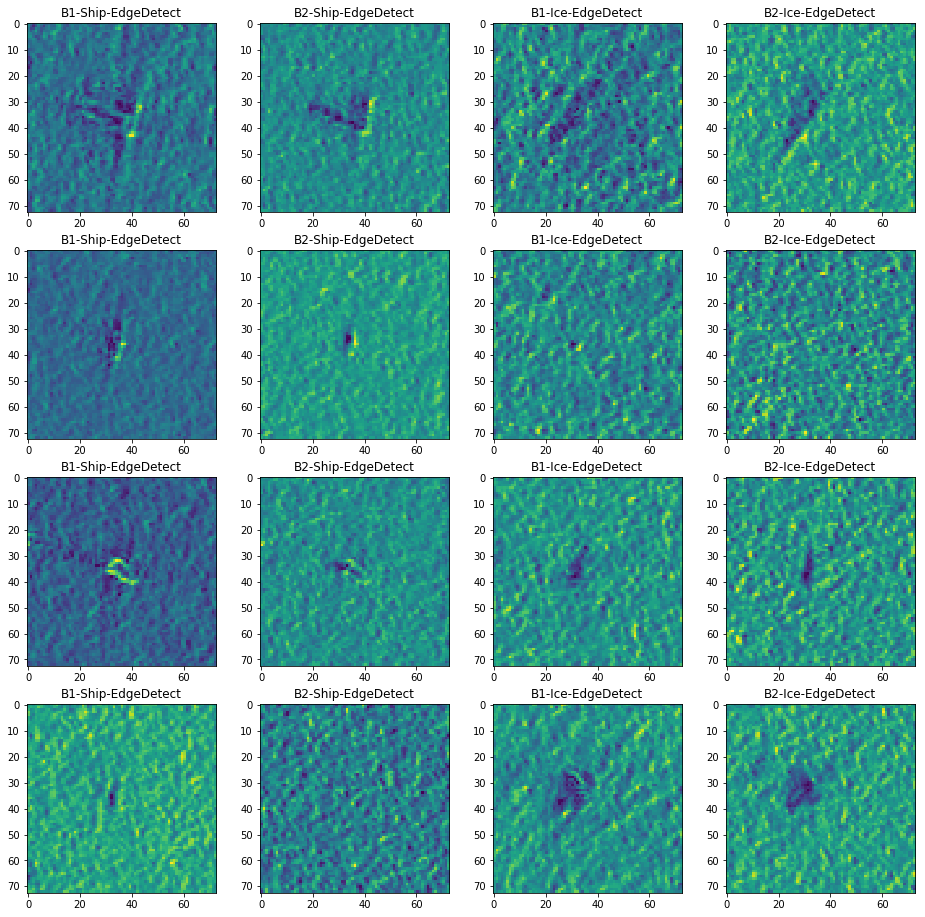

In [81]:
fig = plt.figure(1,figsize=(16,16))
ships,icebergs = sampleImg(train,4)
a=0
for i in range(4):
    a = a+1
    arr = gradientEdgeDetect(np.reshape(np.array(ships.iloc[i,0]),(75,75)))
    ax = fig.add_subplot(4,4,a)
    ax.imshow(arr,cmap='viridis')
    ax.set_title('B1-Ship-EdgeDetect')
    arr = gradientEdgeDetect(np.reshape(np.array(ships.iloc[i,1]),(75,75)))
    a=a+1
    ax = fig.add_subplot(4,4,a)
    ax.imshow(arr,cmap='viridis')
    ax.set_title('B2-Ship-EdgeDetect')
    a = a+1
    arr = gradientEdgeDetect(np.reshape(np.array(icebergs.iloc[i,0]),(75,75)))
    ax = fig.add_subplot(4,4,a)
    ax.imshow(arr,cmap='viridis')
    ax.set_title('B1-Ice-EdgeDetect')
    arr = gradientEdgeDetect(np.reshape(np.array(icebergs.iloc[i,1]),(75,75)))
    a=a+1
    ax = fig.add_subplot(4,4,a)
    ax.imshow(arr,cmap='viridis')
    ax.set_title('B2-Ice-EdgeDetect')
    

plt.show()

In [201]:
#Takes a list of names - the types of transformations
def multiProcess(list):
    #gradient
    #gradientEdgeDetect
    #gradientEdgeDetect2
    #gradientSobel
    #Emboss
    #SobelLeft
    #SobelRight
    #SobelTop
    #SobelBottom
    #outline
    #gradientLaplace
    #gradientLaplace2
    #gradientLaplace3
    #gradientLaplace4
    #gradientLaplace5
    #gradientLaplace6
    transforms = []
    transforms = list
    numT = len(transforms)
    fig = plt.figure(1,figsize=(16,16))
    #ships,icebergs = sampleImg(train,x)
    a=0
    for i in range(4):
        a = a+1
        arr = np.reshape(np.array(ships.iloc[i,0]),(75,75))
        name=''
        
        for j in transforms:
            arr=j(arr)
            str1 = ''.join(str(j))
            str1=re.sub('^<function ', '', str1)
            str1 = str1.split(' ',1)[0]
            name=(name+str1+'-')
        
        name=name[:-1]           
        ax = fig.add_subplot(4,4,a)
        ax.imshow(arr,cmap='viridis')
        #ax.set_title('B1-Ship\n'+name)
        
        a=a+1
        arr = np.reshape(np.array(ships.iloc[i,1]),(75,75))
        name=''
        
        for j in transforms:
            arr=j(arr)
            str1 = ''.join(str(j))
            str1=re.sub('^<function ', '', str1)
            str1 = str1.split(' ',1)[0]
            name=(name+str1+'-')
            
        name=name[:-1]  
        ax = fig.add_subplot(4,4,a)
        ax.imshow(arr,cmap='viridis')
        #ax.set_title('B2-Ship\n'+name)
        
        a = a+1
        arr = np.reshape(np.array(icebergs.iloc[i,0]),(75,75))
        name=''
        
        for j in transforms:
            arr=j(arr)
            str1 = ''.join(str(j))
            str1=re.sub('^<function ', '', str1)
            str1 = str1.split(' ',1)[0]
            name=(name+str1+'-')
            
        name=name[:-1]  
        ax = fig.add_subplot(4,4,a)
        ax.imshow(arr,cmap='viridis')
        #ax.set_title('B1-Ice\n'+name)
        
        a=a+1
        arr = np.reshape(np.array(icebergs.iloc[i,1]),(75,75))
        name=''
        
        for j in transforms:
            arr=j(arr)
            str1 = ''.join(str(j))
            str1=re.sub('^<function ', '', str1)
            str1 = str1.split(' ',1)[0]
            name=(name+str1+'-')

        name=name[:-1]  
        ax = fig.add_subplot(4,4,a)
        ax.imshow(arr,cmap='viridis')
        #ax.set_title('B2-Ice\n'+name)
    

    plt.show()
    
    
    

In [95]:
list1=[Emboss,gradientLaplace6]
multiProcess2(list1)

NameError: name 'x' is not defined

In [98]:
#Takes a list of names - the types of transformations
def multiProcess2(list):
    #gradient
    #gradientEdgeDetect
    #gradientEdgeDetect2
    #gradientSobel
    #Emboss
    #SobelLeft
    #SobelRight
    #SobelTop
    #SobelBottom
    #outline
    #gradientLaplace
    #gradientLaplace2
    #gradientLaplace3
    #gradientLaplace4
    #gradientLaplace5
    #gradientLaplace6
    transforms = []
    transforms = list
    numT = len(transforms)
    fig = plt.figure(1,figsize=(16,16))
    a=0
    for i in range(2):
        a = a+1
        arr = np.reshape(np.array(ships.iloc[i,0]),(75,75))
        name=''
        
        for j in transforms:
            arr=j(arr)
            str1 = ''.join(str(j))
            str1=re.sub('^<function ', '', str1)
            str1 = str1.split(' ',1)[0]
            name=(name+str1+'-')
        
        name=name[:-1]           
        ax = fig.add_subplot(1,4,a)
        ax.imshow(arr,cmap='viridis')
        ax.set_title('B1-Ship\n'+name)
        
        a = a+1
        arr = np.reshape(np.array(icebergs.iloc[i,0]),(75,75))
        name=''
        
        for j in transforms:
            arr=j(arr)
            str1 = ''.join(str(j))
            str1=re.sub('^<function ', '', str1)
            str1 = str1.split(' ',1)[0]
            name=(name+str1+'-')
            
        name=name[:-1]  
        ax = fig.add_subplot(1,4,a)
        ax.imshow(arr,cmap='viridis')
        ax.set_title('B1-Ice\n'+name)
           

    plt.show()
    
    
    

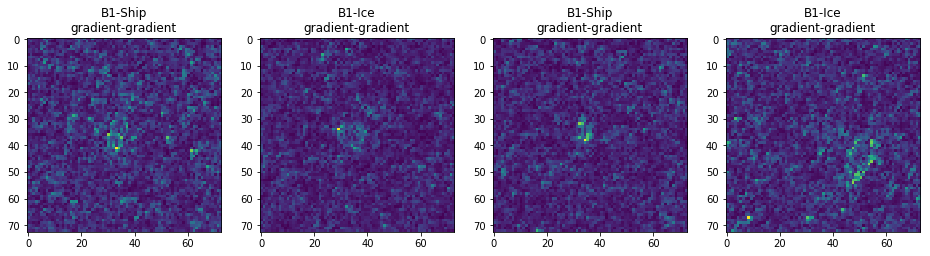

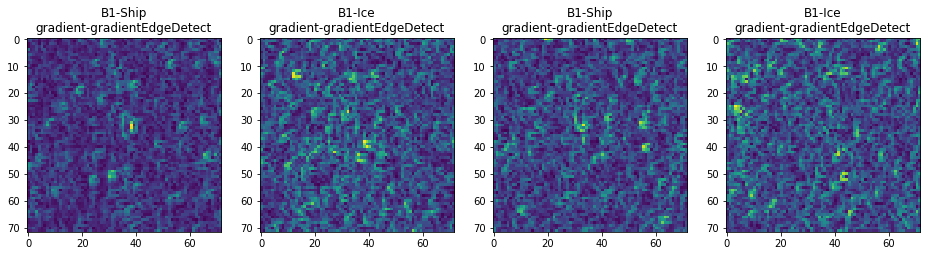

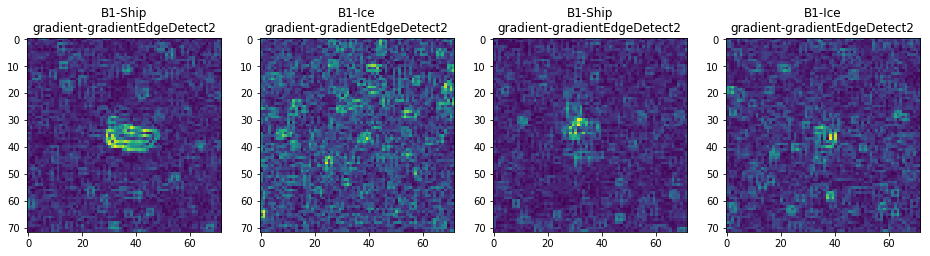

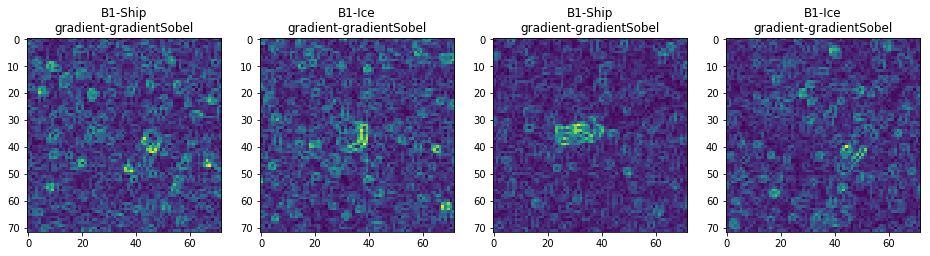

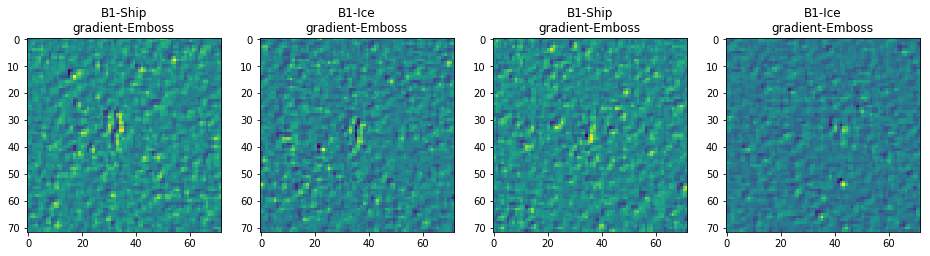

...

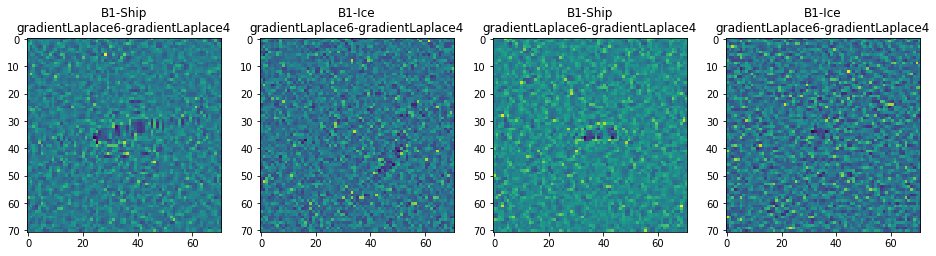

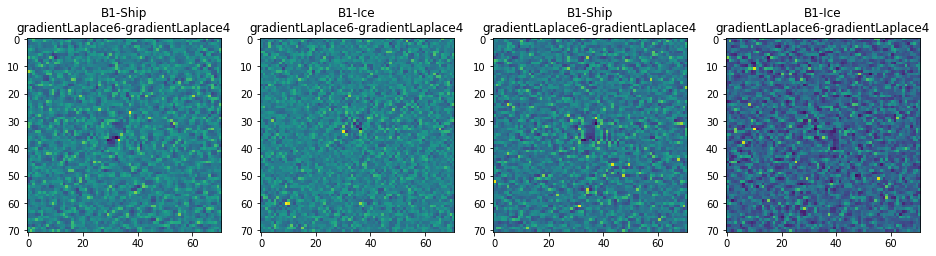

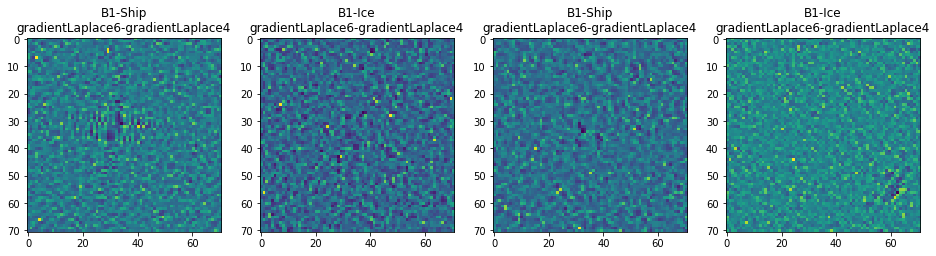

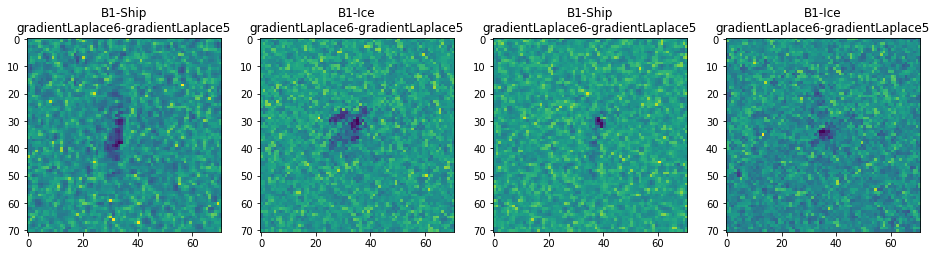

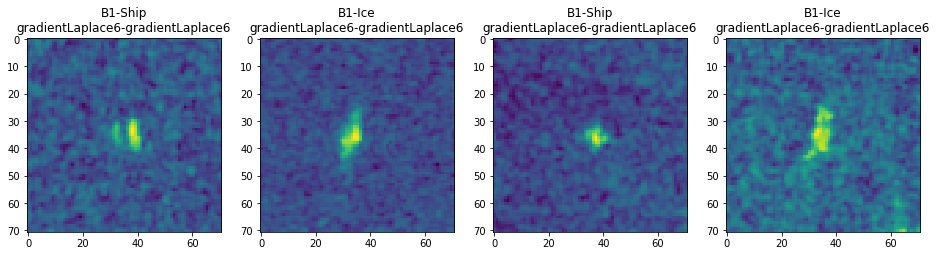

In [101]:
filters =[gradient,gradientEdgeDetect,gradientEdgeDetect2,gradientSobel,Emboss,SobelLeft,SobelRight,SobelTop,
          outline,SobelBottom,gradientLaplace,gradientLaplace2,gradientLaplace3,gradientLaplace4,gradientLaplace4,
          gradientLaplace4,gradientLaplace5,gradientLaplace6]

ships,icebergs = sampleImg(train,4)
#list1=[Emboss,gradientLaplace6]
#multiProcess2(list1)
for f in filters:
    for k in filters:
        lists=[f,k]
        multiProcess2(lists)

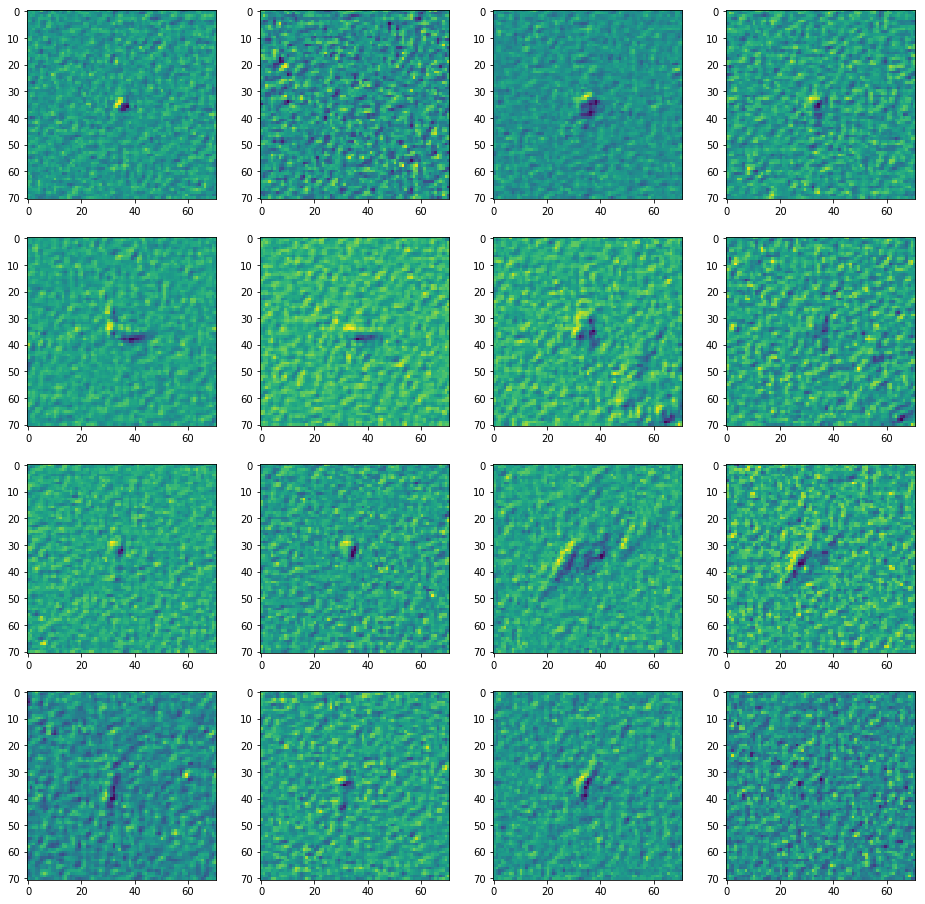

In [435]:
list1=[gradientLaplace9]
      
### -> -1,4,-1
#L2 -> -1,8,-1
#L3 -> -1,5,-1
#L4 -> 1,-4,1
#L5 -> 1,-5,1
#L6 -> 1,8,1
#L7 -> 1,9,1
#L8 -> 1,-8,1
#L9 -> 1,-9,1
ships,icebergs = sampleImg(train,4)
 #     gradientLaplace4]
multiProcess(list1)

list1


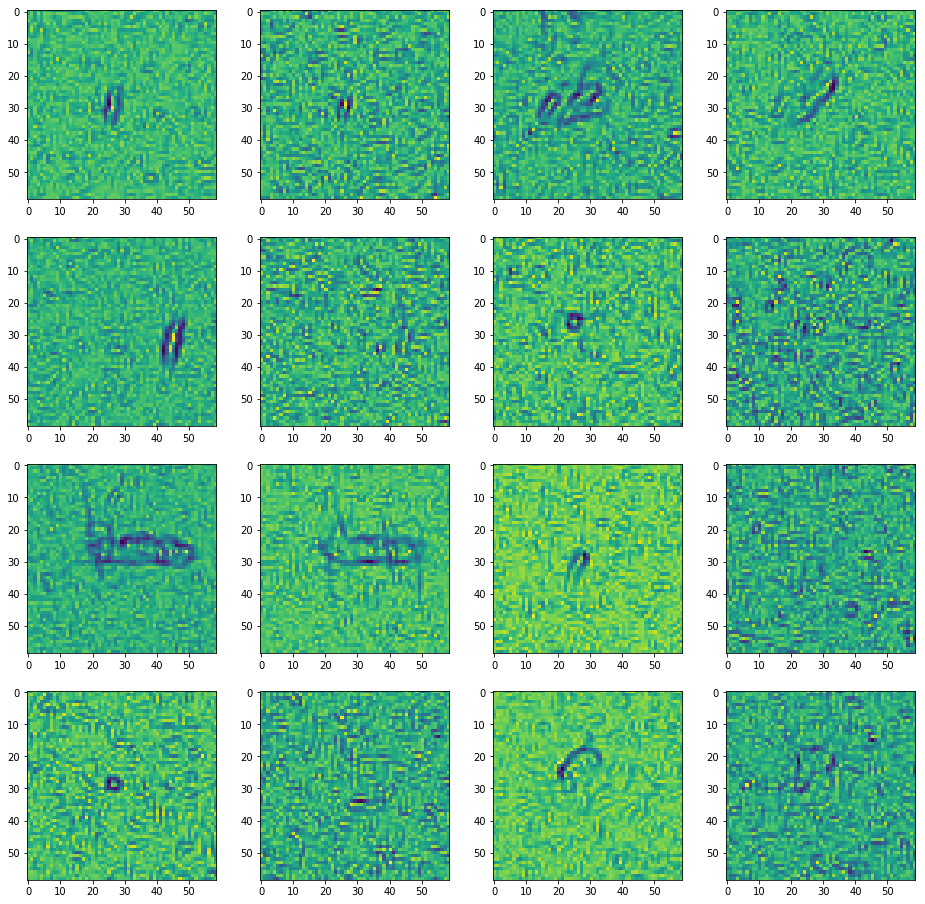

list2


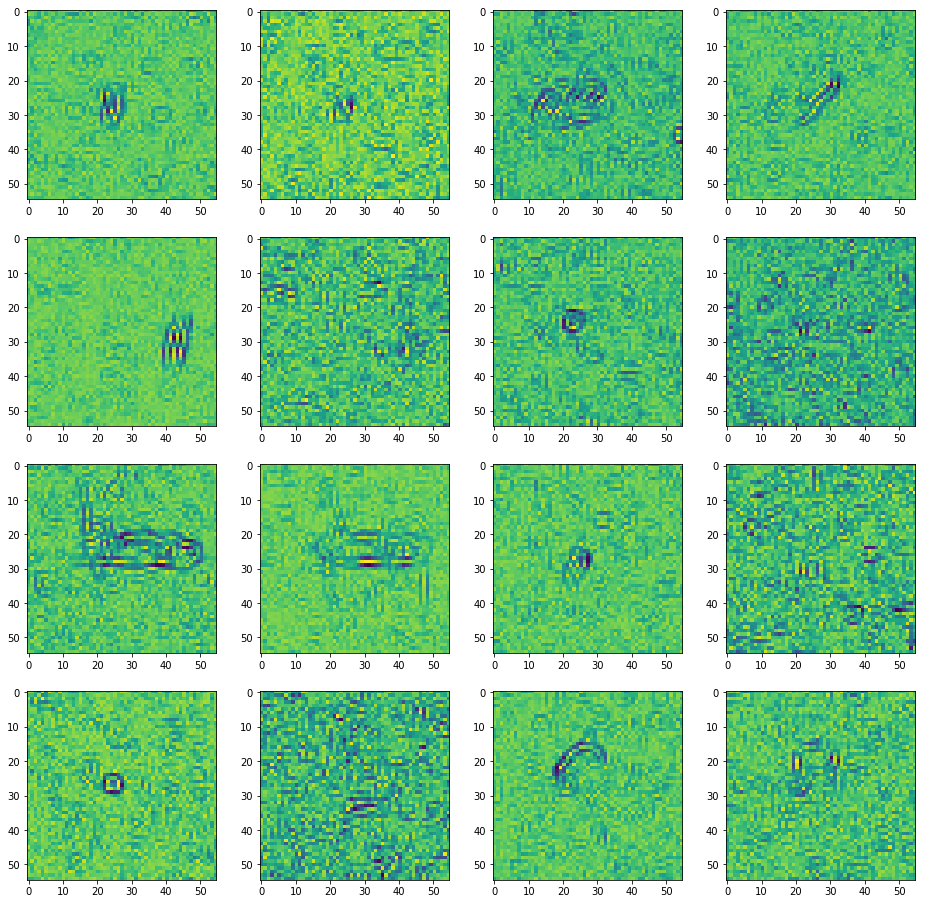

list3


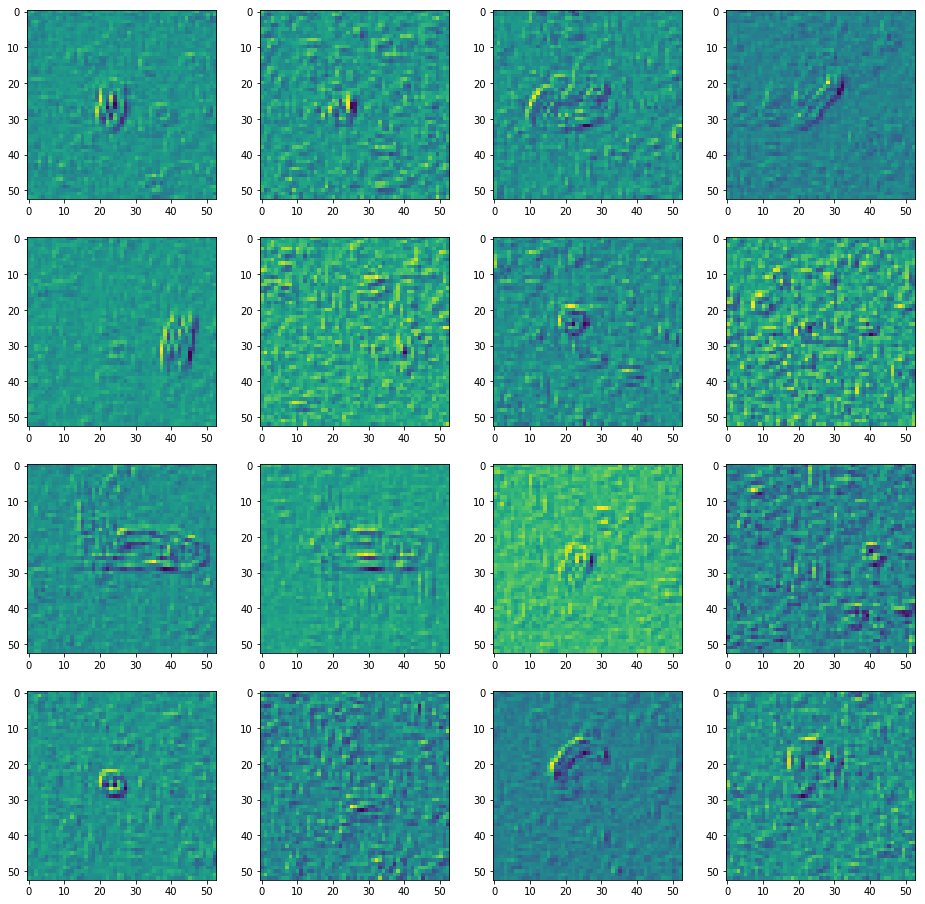

list4


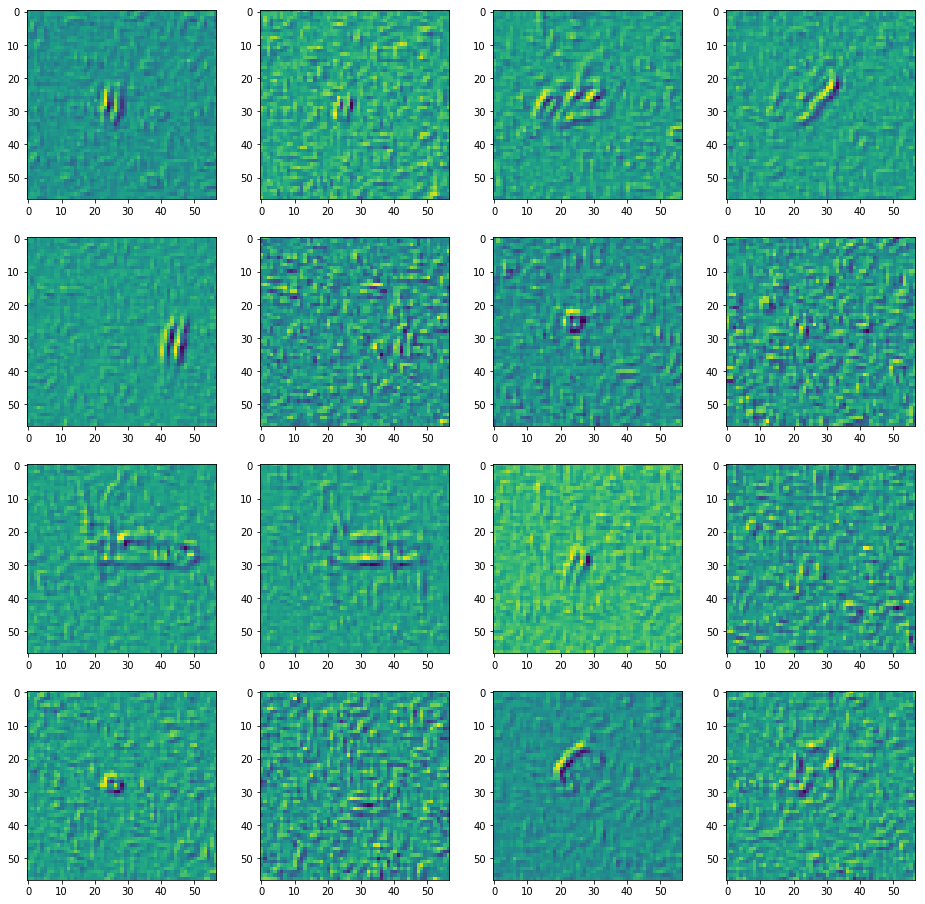

In [352]:
ships,icebergs = sampleImg(train,4)
list1=[gradientLaplace2,gradientLaplace6,gradientLaplace7,
      gradientLaplace7,gradientEdgeDetect2,gradientLaplace7
        ,gradientLaplace9,gradientLaplace2
      ]
list2=[gradientLaplace2,gradientLaplace6,gradientLaplace7,
      gradientLaplace7,gradientEdgeDetect2,gradientLaplace7
        ,gradientLaplace9,gradientLaplace2,gradientEdgeDetect2,gradientLaplace9
      ]
list3=[gradientLaplace2,gradientLaplace6,gradientLaplace7,
      gradientLaplace7,gradientEdgeDetect2,gradientLaplace7
        ,gradientLaplace9,gradientLaplace2,gradientEdgeDetect2,gradientLaplace9,Emboss
      ]
list4=[gradientLaplace2,gradientLaplace6,gradientLaplace7,
      gradientLaplace7,gradientEdgeDetect2,gradientLaplace7
        ,gradientLaplace9,gradientLaplace2,Emboss
      ]
print('list1')
multiProcess(list1)
print('list2')
multiProcess(list2)
print('list3')
multiProcess(list3)
print('list4')
multiProcess(list4)

In [197]:
import re
def hi():
    print(1)

def hey():
    print(2)
    
def hello():
    print(3)
    
def go(list):
    list = list
    name=''
    
    for i in list:
        i()
        str1 = ''.join(str(i))
        str1=re.sub('^<function ', '', str1)
        str1 = str1.split(' ',1)[0]
        name=(name+str1+'-')
        
    name=name[:-1]
    print(name)

def go2(list):
    list
    return list

test=[hi,hey,hello]
go(test)
print(len(ships))

1
2
3
hi-hey-hello
2


In [59]:
test=[hi,hey,hello]
go(test)

1
2
3
[<function hi at 0x7f3dacc1dc80>, <function hey at 0x7f3dacc1df28>, <function hello at 0x7f3dacc1dea0>]
